In [1]:
from rasterio.warp import reproject, Resampling, calculate_default_transform
import rasterio as rio
import geopandas as gpd
import pandas as pd
import os
from shapely import wkt
from shapely.geometry import box
import leafmap.foliumap as leafmap
import folium
import rioxarray as rioxr
import matplotlib.pyplot as plt
import numpy as np
import osmnx as ox
from skimage import io
import xarray as xr
import shapely
from typing import Any, Union, Dict, List

In [2]:
from shapely.geometry import shape as geo_shape
from shapely import Polygon, MultiPolygon
from rasterio.features import shapes as rio_shapes
from rasterio import features
from skimage.color import rgb2gray
from skimage.filters import sobel
from skimage.segmentation import  watershed
from pathlib import Path
from tqdm import tqdm

In [3]:
pd.options.display.max_columns = 50

In [4]:
from src.config import *
from src.io.utils_io import load_maxar_items, load_rs_path_toy, load_roi_town, check_dir, make_path, save_pickle
from src.stac.utils_stac import get_nearest_match_geometry_view
from src.utils import create_bbox, get_maxar_items_on_roi
from src.rs_processing.processing import crop_rs_on_shape, rasterize_shp
from src.io.utils_io import load_pair_raster,make_path,load_pickle


In [5]:
CRS = 32629
s_buffer = 157

In [6]:
project_path = os.path.expanduser("~/Documents/Projects/building_damage")
out_dir_path = os.path.join(project_path, "Data/processed")
building_root_path = os.path.join(project_path, "Data/raw/building_footprint")
raw_data_path = os.path.join(project_path, "Data/raw")

In [7]:
name = "Adassil"
delta_event = "before"
rs_test_path = os.path.join(out_dir_path, name, delta_event, "1030010083A10700-visual.tif")

In [8]:
test_set= load_pickle(make_path("dataset_labelled_test.pkl", processed_dir_path, "dataset", "png", "data_labelled"))

In [9]:
test_set

,annotation_id,labels_path,img_id,after_path,before_path
8,9,/home/rustt/Documents/Projects/building_damage...,49a91dea-ed40-4772-b6b9-f9683509b8ac,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...
18,19,/home/rustt/Documents/Projects/building_damage...,d56aa5a0-6a45-44dd-a227-9a5eab169393,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...
15,16,/home/rustt/Documents/Projects/building_damage...,465955c3-57fd-4b53-b347-1e9ea61d26d7,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...


In [266]:
ds =  load_pickle(make_path("dataset_visual_157.pkl", processed_dir_path, "dataset", "png"))

In [11]:
ds.before_path.nunique()

183

In [12]:
ds[["before_path", "before_path_png"]].values[:5]

array([['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/before/58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e.tif',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/before/58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e.png'],
       ['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/before/7c6e421b-866a-4ef4-b8b4-0cbbedacd46d.tif',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/before/7c6e421b-866a-4ef4-b8b4-0cbbedacd46d.png'],
       ['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/before/8510a085-9449-4c68-8506-99178fcf2d01.tif',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/before/8510a085-9449-4c68-8506-99178fcf2d01.png'],
       ['/home/rustt/Documents/Projects/building_damage/moroc

In [15]:
shape = ds[ds.town_name == "695"].buffer(s_buffer)

In [267]:
ds_test = ds[ds.town_name == "695"]

In [203]:
def get_building_from_location(loc: Union[shapely.Point, shapely.Polygon], s_buffer: int, crs_ox: int=4326, crs_src: int=CRS): 

    if isinstance(loc, shapely.Point):

        loc = (
            gpd.GeoSeries([loc], 
                          crs=crs_src)
            .buffer(s_buffer)
            .to_crs(crs_ox)
        )

    shape = box(*loc.bounds.values.ravel())

    try:
    
        buildings = ox.features_from_polygon(shape, tags={"building":True})
    except:
        print("no buildings found")
        return None
        
    buildings = buildings.reset_index(drop=True)[["geometry"]]
    buildings = buildings.to_crs(crs_src)
    
    return buildings

In [204]:
def vectorize_rs(rs: np.ndarray, rs_src: xr.DataArray, out_shp_path:str, col_id:str): 
    rs = rs.astype(np.int16)
    shape_gen = [(geo_shape(s), v) for s, v in rio_shapes(rs, transform=rs_src.rio.transform())]
    gdf = gpd.GeoDataFrame(dict(zip(["geometry", "class"], zip(*shape_gen))), crs=CRS) #rs_src.rio.crs
    if isinstance(col_id, str):
        gdf[col_id] = np.arange(len(gdf))
    if isinstance(out_shp_path, str):
        gdf.to_file(out_shp_path)

    return gdf

In [205]:
pwd

'/home/rustt/Documents/Projects/building_damage/morocco_damage_building/notebooks/data_processing'

In [206]:
def extract_urban_area(before_rs_path: str, 
                       loc: Union[shapely.Point, 
                       shapely.Polygon], 
                       method_seg: str,
                       fill_holes:bool,
                       resolution: int,
                       out_shp_path: str=None, 
                       s_buffer=157,
                       building_buffer,
                      ): 
    
    rs_b = rioxr.open_rasterio(before_rs_path)

    # if no building is found
    urban_zone=gpd.GeoDataFrame(geometry=[loc], crs=CRS)
    
    geom_building = get_building_from_location(loc, s_buffer)
    #print(f"found {geom_building.shape[0]} buildings")

    if geom_building is not None:

        urban_zone = segmentation_factory(method_seg, **{"rs_b":rs_b, "buffer":building_buffer, "geom_building":geom_building})

        urban_zone = process_urban_area(urban_zone, resolution, method, fill_holes)
    else:
        # check how to manage missing columns
        print(f"No building found : {Path(before_rs_path).stem}")
        
    if isinstance(out_shp_path, str):
        urban_zone.to_file(out_shp_path)
        return out_shp_path
    return urban_zone

In [132]:
def segmentation_factory(method_name, **kwargs): 
    factory_func = {
        "watershed": watershed_segmentation, 
        "osm_buffer": osm_buffer_segmentation, 
    }
    return factory_func[method_name](**kwargs)

def watershed_segmentation(**kwargs) -> gpd.GeoDataFrame: 
    rs_b = kwargs["rs_b"]
    data = rs_b.data.transpose(1, 2, 0)
    geom_building = kwargs["geom_building"]
    
    gradient = sobel(rgb2gray(data))
    lines = watershed(gradient, markers=500, compactness=0.0001,watershed_line=True)
    lines = np.where(lines == 0, 1, 0)
    lines = lines.astype(np.int16)
    
    gdf = vectorize_rs(lines, rs_b, out_shp_path=None, col_id="id_seg")    
    
    urban_area = gdf.sjoin(geom_building, how="inner", predicate="intersects").drop("index_right", axis=1)
    urban_area.geometry = urban_area.simplify(5)
    urban_area.geometry = urban_area.buffer(5)
    
    return urban_area

def osm_buffer_segmentation(**kwargs) ->  gpd.GeoDataFrame:
    urban_area = kwargs["geom_building"]
    urban_area.geometry = urban_area.buffer(kwargs["buffer"])
    return urban_area

In [148]:
import h3pandas as h3
def process_urban_area(urban_area: gpd.GeoDataFrame, resolution:int, method:str, fill_holes: bool) -> gpd.GeoDataFrame: 
    """
    - simplify, dissolve and fill holes of urban area
    - create hex grid
    """
    if fill_holes:
        urban_area = urban_area.dissolve()
        
        if isinstance(urban_area.geometry.item(), MultiPolygon): 
            geoms = list(urban_area.geometry.item().geoms)
        else:
            geoms = list(urban_area.geometry)
            
        urban_area["geometry"] =  MultiPolygon(Polygon(geom.exterior) for geom in geoms)

    urban_area = create_hex_grid(urban_area, resolution)
    #urban_area = urban_area[["id_hex", "geometry"]] 

    return urban_area

In [134]:
def create_hex_grid(gdf, resolution=13): 
    """
    reolution table : https://h3geo.org/docs/core-library/restable/
    """
    gdf = gdf.to_crs(4326)
    hexagons = gdf.h3.polyfill_resample(resolution)
    hexagons = hexagons.h3.h3_get_resolution()
    hexagons = hexagons.h3.cell_area("m^2")
    hexagons = hexagons.to_crs(CRS).reset_index().rename({"h3_polyfill":"id_hex", "h3_cell_area":"cell_area", "h3_resolution":"grid_resolution"}, axis=1)
    return hexagons

In [136]:
def rasterize_shp(gdf: gpd.GeoDataFrame, src_rs: str, out_path: str) -> str:
    
    with rio.open(os.path.join(src_rs)) as rs_src:
        meta = rs_src.meta.copy()

        meta = {
            **meta, 
            **{
                "count":1, 
                "driver": "GTiff",
            }
        }
        
        with rio.open(out_path, 'w+', **meta) as out:
            out_arr = out.read(1)
        
            shapes = [geom  for geom  in gdf.geometry]
        
            burned = rio.features.rasterize(shapes=shapes, 
                                            out_shape = rs_src.shape,
                                            transform = rs_src.transform,
                                            all_touched = True,
                                            fill = 0,  
                                            dtype = None)
            out.write_band(1, burned)
            
    return out_path

### Pipeline

In [157]:
dataset.img_id

0      58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e
1      7c6e421b-866a-4ef4-b8b4-0cbbedacd46d
2      8510a085-9449-4c68-8506-99178fcf2d01
3      46069c75-000e-4b59-8892-25198ee96e0a
4      51186d96-6b79-407a-be01-d5d2e2d147af
                       ...                 
178    9bbce698-6baa-45c0-98ea-c694f489c0e5
179    071fc49d-bea3-473c-8ebc-4a6c011dfff2
180    0f349d4b-145c-4047-b414-2b0de3a42292
181    54b002bb-3b73-48f2-9d40-5d203096022e
182    69986d53-9195-4dc9-984b-4485ed6fbdf2
Name: img_id, Length: 183, dtype: object

In [158]:
type_item = "visual"
s_buffer = 157
save= True
method = "osm_buffer"
fill_holes=True
resolution=13
building_buffer=7

out_dir = check_dir(processed_dir_path, "dataset", "buildings")
ds_path = make_path("png", processed_dir_path, "dataset")


dataset =  load_pickle(make_path(f"dataset_{type_item}_{s_buffer}.pkl", ds_path))
dataset_labelled =  load_pickle(make_path("dataset_labelled.pkl", ds_path, "data_labelled"))

col_olds = [_ for _ in dataset.columns if _.startswith("urban_area_path")]

if col_olds: 
    dataset = dataset.drop(col_olds, axis=1) 
    dataset_labelled = dataset_labelled.drop(col_olds, axis=1)

urban_path = []

for i, row in tqdm(dataset.iterrows(), total=len(dataset)):
    b_rs_path, name, loc = row["before_path"], row["town_name"], row["geometry"]
    pair_id = Path(b_rs_path).stem

    # we use b_rs_path
    urb_path = extract_urban_area(before_rs_path=b_rs_path, 
                                  loc=loc, 
                                  method_seg=method,
                                  fill_holes=fill_holes,
                                  resolution=resolution,
                                  building_buffer=building_buffer,
                                  out_shp_path=make_path(f"{name}.shp", out_dir))

    urban_path.append((pair_id, urb_path))

urban_path = pd.DataFrame(urban_path, columns=["img_id", "urban_area_path"])

if save:
    # full dataset
    if "img_id" not in dataset.columns: 
        img_id = [Path(row["before_path"]).stem for i,row in dataset.iterrows()]
        dataset["img_id"] = img_id
        
    dataset = dataset.merge(urban_path, on="img_id")
    
    save_pickle(dataset, make_path(f"dataset_{type_item}_{s_buffer}.pkl", ds_path))
    # labelled ds
    dataset_labelled = dataset_labelled.merge(urban_path, on="img_id")
    save_pickle(dataset_labelled, make_path("dataset_labelled.pkl", ds_path, "data_labelled"))


  0%|                                                           | 0/183 [00:00<?, ?it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
  1%|▎                                                  | 1/183 [00:00<00:41,  4.43it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
  1%|▌                                                  | 2/183 [00:00<01:00,  3.01it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
  2%|▊                                                  | 3/183 [00:01<01:02,  2.86it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESR

no buildings found
No building found : 2cd84a6b-c4a5-4254-a3d4-2fd233530def


/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 13%|██████▌                                           | 24/183 [00:20<02:13,  1.19it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 14%|██████▊                                           | 25/183 [00:21<02:06,  1.24it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 14%|███████                                           | 26/183 [00:22<02:34,  1.02it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 15%|███████▍                           

no buildings found
No building found : 776a4eb4-734b-4fdb-9e78-d871bde1dbdf


/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 30%|███████████████                                   | 55/183 [00:53<02:00,  1.06it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 31%|███████████████▎                                  | 56/183 [00:54<02:01,  1.05it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 31%|███████████████▌                                  | 57/183 [00:55<02:06,  1.01s/it]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 32%|████████████████                   

no buildings found
No building found : 11623aab-7ffd-4075-a3f0-6e5f1077daa1


/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 33%|████████████████▍                                 | 60/183 [00:58<01:44,  1.18it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 33%|████████████████▋                                 | 61/183 [00:59<01:56,  1.05it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 34%|████████████████▉                                 | 62/183 [01:00<01:48,  1.12it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 34%|█████████████████▏                 

no buildings found
No building found : b57e01a5-6b96-41c9-9a09-30ef7a3dfb2b


/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 39%|███████████████████▋                              | 72/183 [01:08<01:25,  1.30it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 40%|███████████████████▉                              | 73/183 [01:09<01:21,  1.34it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 40%|████████████████████▏                             | 74/183 [01:10<01:29,  1.22it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 41%|████████████████████▍              

no buildings found
No building found : 8855e718-c994-4141-92ad-6d876393d557


/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 75%|████████████████████████████████████▉            | 138/183 [02:15<00:43,  1.03it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 76%|█████████████████████████████████████▏           | 139/183 [02:16<00:40,  1.07it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 77%|█████████████████████████████████████▍           | 140/183 [02:17<00:40,  1.07it/s]/tmp/ipykernel_89154/3202609876.py:28: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  urban_zone.to_file(out_shp_path)
 77%|███████████████████████████████████

In [171]:
save_pickle(urban_path, make_path("urban_area.pkl", processed_dir_path, "dataset"))

In [20]:
ds_path = make_path("png", processed_dir_path, "dataset")

dataset =  load_pickle(make_path("dataset_visual_157.pkl", processed_dir_path, "dataset", "png"))
dataset_labelled =  load_pickle(make_path("dataset_labelled.pkl", ds_path, "data_labelled"))

In [21]:
dataset.columns

Index(['before_path', 'after_path', 'town_name', 'geometry', 'quadkey',
       'before_href', 'before_view_off_nadir', 'before_view_azimuth',
       'before_view_incidence_angle', 'before_view_sun_azimuth',
       'before_view_sun_elevation', 'before_platform', 'before_clouds_percent',
       'after_href', 'after_view_off_nadir', 'after_view_azimuth',
       'after_view_incidence_angle', 'after_view_sun_azimuth',
       'after_view_sun_elevation', 'after_platform', 'after_clouds_percent',
       'id_pair', 'diff_view_off_nadir', 'diff_view_incidence',
       'diff_view_sun_azimuth', 'diff_avg', 'before_path_png',
       'after_path_png', 'img_id', 'urban_area_path'],
      dtype='object')

In [161]:
dataset_labelled.columns

Index(['annotation_id', 'labels_path', 'img_id', 'after_path', 'before_path',
       'urban_area_path'],
      dtype='object')

In [23]:
dataset.urban_area_path.iloc[0]

'/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/buildings/480.shp'

In [159]:
dataset_labelled.after_path.values[:5]

array(['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/after/3d2355ab-f7b9-4e01-8cb0-0926b0158fd6.png',
       '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/after/06c5f930-99be-4350-92ac-83ec3f5fc66d.png',
       '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/after/6d34c661-ebe2-4b5a-b1ad-abcbd24ff3dd.png',
       '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/after/7c3769e3-97a7-493e-9689-17207e6b9129.png',
       '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/after/8e7cdfe0-8423-49a9-88d0-643584beb4ea.png'],
      dtype=object)

In [164]:
for _, row in dataset_labelled[["img_id", "after_path", "before_path", "labels_path","urban_area_path"]][:3].iterrows():
    print(f"==== img {row['img_id']}")
    print(f"before_path : {row['before_path']}")
    print(f"after_path : {row['after_path']}")
    print(f"labels_path : {row['labels_path']}")
    print(f"urban_path : {row['urban_area_path']}")
    print('\n')

==== img 3d2355ab-f7b9-4e01-8cb0-0926b0158fd6
before_path : /home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/before/3d2355ab-f7b9-4e01-8cb0-0926b0158fd6.png
after_path : /home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/after/3d2355ab-f7b9-4e01-8cb0-0926b0158fd6.png
labels_path : /home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/labels/task-1-annotation-1-by-1-tag-damage_building-0.png
urban_path : /home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/buildings/79.shp


==== img 06c5f930-99be-4350-92ac-83ec3f5fc66d
before_path : /home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/before/06c5f930-99be-4350-92ac-83ec3f5fc66d.png
after_path : /home/rustt/Documents/Projects/building_damage/morocco_damage_bui

<Axes: >

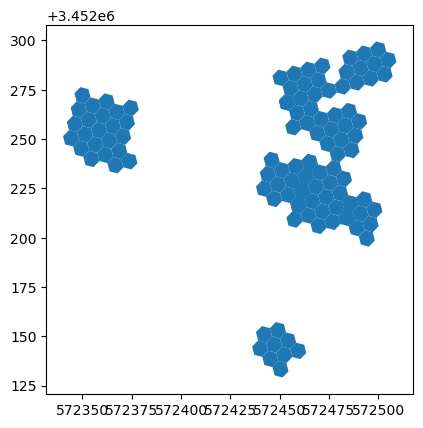

In [176]:
urban = gpd.read_file(dataset[dataset.img_id == '465955c3-57fd-4b53-b347-1e9ea61d26d7']["urban_area_path"].item())
after = dataset[dataset.img_id == '465955c3-57fd-4b53-b347-1e9ea61d26d7']["after_path_png"].item()
urban.plot()


In [202]:
building = get_building_from_location(row["geometry"], 157)

no buildings found


In [201]:
building.plot()

AttributeError: 'NoneType' object has no attribute 'plot'

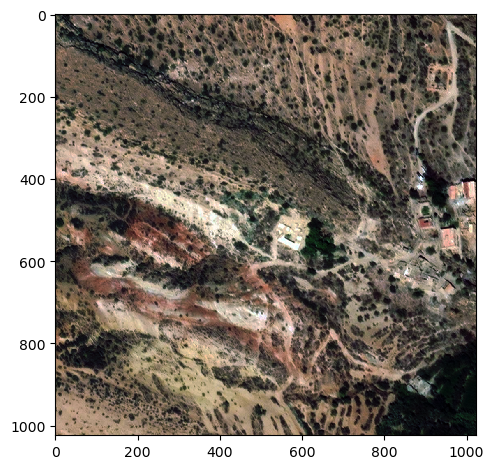

In [177]:
io.imshow(after)

In [165]:
urban = gpd.read_file("/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/buildings/79.shp")
after_path = "/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/data_labelled/after/3d2355ab-f7b9-4e01-8cb0-0926b0158fd6.png"

<Axes: >

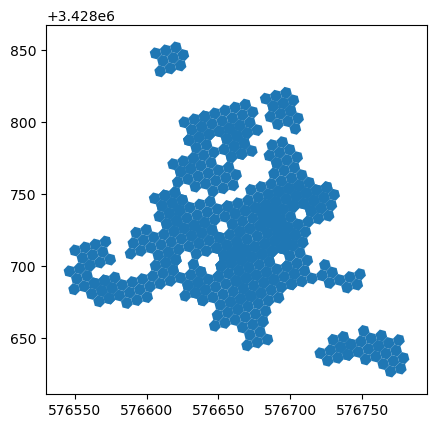

In [166]:
urban.plot()

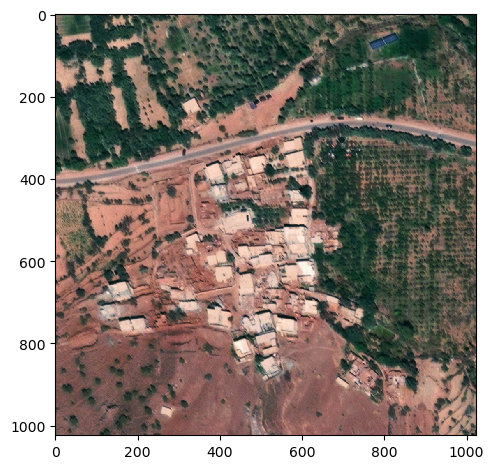

In [167]:
io.imshow(after_path)

In [70]:
dataset[["after_path", "before_path"]].sample(10).values[:5]

array([['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/after/366b59f8-5589-41ae-9503-a4296c74efff.tif',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/before/366b59f8-5589-41ae-9503-a4296c74efff.tif'],
       ['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/after/20c86179-540f-4256-a215-ebf1e024833b.tif',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/before/20c86179-540f-4256-a215-ebf1e024833b.tif'],
       ['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/after/05cd6177-b567-4a42-9fbc-69ce87cd0a76.tif',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/interim/dataset/tif/before/05cd6177-b567-4a42-9fbc-69ce87cd0a76.tif'],
       ['/home/rustt/Documents/Projects/building_damage/morocco_damage

In [68]:
dataset[["after_path_png", "before_path_png"]].values[:5]

array([['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/after/58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e.png',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/before/58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e.png'],
       ['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/after/7c6e421b-866a-4ef4-b8b4-0cbbedacd46d.png',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/before/7c6e421b-866a-4ef4-b8b4-0cbbedacd46d.png'],
       ['/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/after/8510a085-9449-4c68-8506-99178fcf2d01.png',
        '/home/rustt/Documents/Projects/building_damage/morocco_damage_building/data/processed/dataset/png/before/8510a085-9449-4c68-8506-99178fcf2d01.png'],
       ['/home/rustt/Documents/Projects/building_damage/mo

### Tests seg methods

In [180]:
img_id_test = "465955c3-57fd-4b53-b347-1e9ea61d26d7"

In [229]:
#"test with new method"
type_item = "visual"
s_buffer = 157
save= True
resolution=13

out_dir = check_dir(processed_dir_path, "dataset", "buildings")
ds_path = make_path("png", processed_dir_path, "dataset")

dataset =  load_pickle(make_path(f"dataset_{type_item}_{s_buffer}.pkl", ds_path))
dataset_labelled =  load_pickle(make_path("dataset_labelled.pkl", ds_path, "data_labelled"))

col_olds = [_ for _ in dataset.columns if _.startswith("urban_area_path")]

if col_olds: 
    dataset = dataset.drop(col_olds, axis=1) 
    dataset_labelled = dataset_labelled.drop(col_olds, axis=1)

urban_path = []
cnt=0

for i, row in tqdm(dataset.iterrows(), total=len(dataset)):
    if cnt==3: 
        break
    b_rs_path, name, loc = row["before_path"], row["town_name"], row["geometry"]
    pair_id = row["id_pair"]

    urb_types = []
    # we use b_rs_path
    for method in ["osm_buffer"]:
        urb_types.append(extract_urban_area(before_rs_path=b_rs_path, 
                                      loc=loc, 
                                      method_seg=method,
                                      resolution=resolution,
                                      out_shp_path=None))#out_shp_path=make_path(f"{name}.shp", out_dir))

    urban_path.append((pair_id, *urb_types))
    cnt+=1

#urban_path = pd.DataFrame(urban_path, columns=["img_id", "urban_area_path"])

  2%|▊                                                  | 3/183 [00:00<00:35,  5.07it/s]


In [268]:
img_id = "465955c3-57fd-4b53-b347-1e9ea61d26d7"
row = dataset[dataset.img_id == img_id]
row_label = dataset_labelled[dataset_labelled.img_id == img_id]

In [269]:
row.columns

Index(['before_path', 'after_path', 'town_name', 'geometry', 'quadkey',
       'before_href', 'before_view_off_nadir', 'before_view_azimuth',
       'before_view_incidence_angle', 'before_view_sun_azimuth',
       'before_view_sun_elevation', 'before_platform', 'before_clouds_percent',
       'after_href', 'after_view_off_nadir', 'after_view_azimuth',
       'after_view_incidence_angle', 'after_view_sun_azimuth',
       'after_view_sun_elevation', 'after_platform', 'after_clouds_percent',
       'id_pair', 'diff_view_off_nadir', 'diff_view_incidence',
       'diff_view_sun_azimuth', 'diff_avg', 'before_path_png',
       'after_path_png', 'img_id'],
      dtype='object')

In [270]:
row_label.columns

Index(['annotation_id', 'labels_path', 'img_id', 'after_path', 'before_path'], dtype='object')

In [284]:
arr_b = rioxr.open_rasterio(row["before_path"].item()).data.transpose(1, 2, 0)
arr_al = io.imread(row_label["after_path"].item())
arr_a = rioxr.open_rasterio(row["after_path"].item()).data.transpose(1, 2, 0)                          

## Influence du buffer sur la maille

In [250]:
resolution = 13
method = "osm_buffer"
urb_types = extract_urban_area(before_rs_path=row["before_path"].item(), 
                              loc=row["geometry"].item(), 
                              method_seg=method,
                              resolution=resolution,
                              out_shp_path=None)

In [251]:
row["geometry"]

168    POINT (572339.179 3452264.867)
Name: geometry, dtype: geometry

In [394]:
building = get_building_from_location(row["geometry"].item(), 157)

<Axes: >

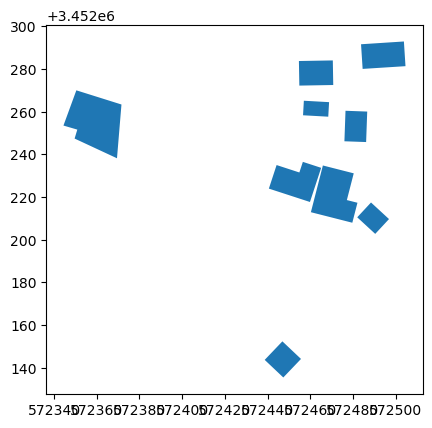

In [395]:
building.plot()

<Axes: >

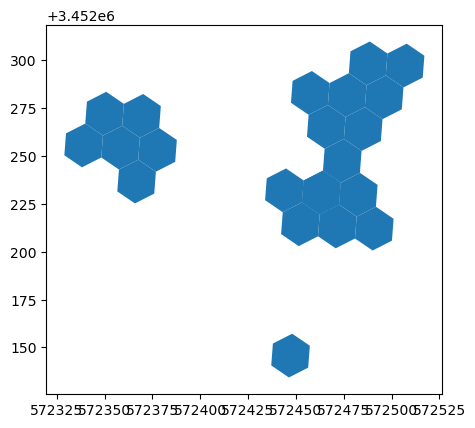

In [399]:
building = get_building_from_location(row["geometry"].item(), 157)
building.geometry = building.buffer(7)
building = building.to_crs(4326)
hexagons = building.h3.polyfill_resample(12)
hexagons = hexagons.h3.h3_get_resolution()
hexagons = hexagons.h3.cell_area("m^2")
hexagons = hexagons.to_crs(CRS).reset_index().rename({"h3_polyfill":"id_hex", "h3_cell_area":"cell_area", "h3_resolution":"grid_resolution"}, axis=1)
hexagons.plot()

buffer de 7 intéressant pour une résolution hex de 12

(9, 1)


/home/rustt/miniforge3/envs/damage_detection/lib/python3.10/site-packages/h3pandas/h3pandas.py:751: UserWarning: 91 rows did not generate a H3 cell.Consider using a finer resolution.
  warnings.warn(



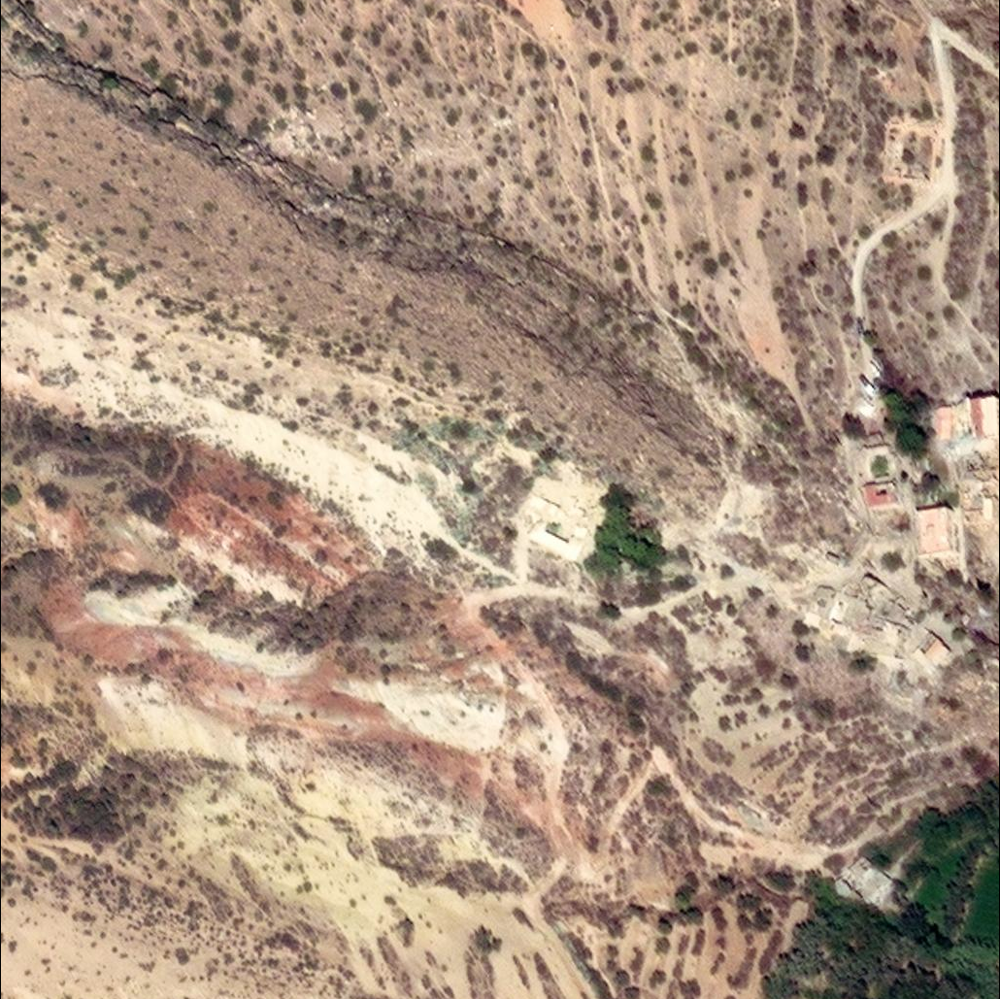
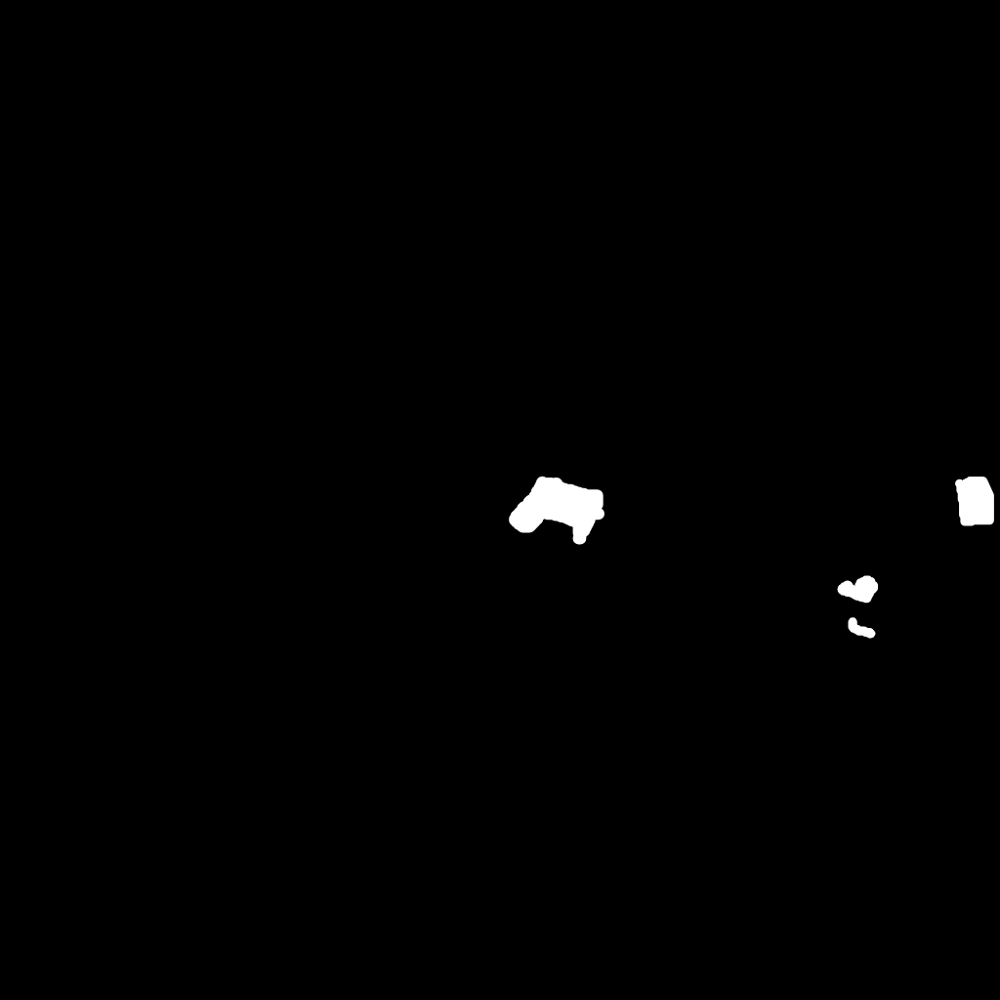

In [393]:
import folium
from folium import raster_layers
from shapely import Point 

s_buffer = 157

rs_a_path = row["after_path"].item()
#rs_a_path = dataset.loc[dataset.id_pair == urban_path[1][0], "after_path"].item()
rs_a = rioxr.open_rasterio(rs_a_path)
data = rs_a.data.transpose(1, 2, 0)

label = row_label["labels_path"].item()
label_data = io.imread(label)
# label_rs_path = mask_array_to_geotiff(label_data, rs_path_src=rs_a_path, out_path="label_rs_viz.tif")
# label_rs = rioxr.open_rasterio(label_rs_path)

loc = row["geometry"].item()
#loc = dataset.loc[dataset.id_pair == urban_path[1][0], "geometry"].item()

geom_building = get_building_from_location(loc, s_buffer)
print(geom_building.shape)
#data = rs_b.data.transpose(1, 2, 0)

bbox = gpd.GeoSeries(box(*rs_a.rio.bounds()), crs=CRS).to_crs(4326)
min_lon, min_lat, max_lon, max_lat = bbox.bounds.values.squeeze()

# create the map
map_ = folium.Map(location=[min_lat, min_lon], zoom_start=17)

# Overlay the image
map_.add_child(raster_layers.ImageOverlay(data, opacity=0.8, \
         bounds =[[min_lat, min_lon], [max_lat, max_lon]], name="rs_a"))


# Overlay the image
map_.add_child(raster_layers.ImageOverlay(label_data, opacity=0.8, \
         bounds =[[min_lat, min_lon], [max_lat, max_lon]], name="label"))


folium.GeoJson(building.buffer(5), name="building_buffer", style_function=lambda x: {"color":"red", "opacity":0.1, "fillOpacity":0.3}).add_to(map_)
folium.GeoJson(building, name="building", style_function=lambda x: {"color":"yellow", "opacity":0.1, "fillOpacity":0.1}).add_to(map_)

urb_types = urb_types.drop_duplicates("geometry")
folium.GeoJson(urb_types, style_function=lambda x: {"color":"green", "opacity":0.3, "fillOpacity":0.1}, name="hex_grid_13").add_to(map_)

resample_urban = urb_types.set_index("id_hex").to_crs(4326)
resample_urban = resample_urban.h3.polyfill_resample(12)
resample_urban = resample_urban.to_crs(CRS)
resample_urban = resample_urban.drop_duplicates("geometry")
folium.GeoJson(resample_urban, style_function=lambda x: {"color":"green", "opacity":0.3, "fillOpacity":0.1}, name="hex_grid_12").add_to(map_)

folium.LayerControl().add_to(map_)
map_

In [258]:
label_data.shape

(1024, 1024)

In [369]:
np.sqrt(0.000307092*1e6)

17.524040629946054

In [370]:
np.sqrt(47)

6.855654600401044

In [388]:
aire = 333.5
#aire = 3*np.sqrt(3)*(c**2)/2
#np.sqrt(2*aire) = 3*np.sqrt(3)*c 
c = np.sqrt(2*aire/ (3*np.sqrt(3)))
c

11.32979301884314

In [389]:
aire = 47.6
#aire = 3*np.sqrt(3)*(c**2)/2
#np.sqrt(2*aire) = 3*np.sqrt(3)*c 
c = np.sqrt(2*aire/ (3*np.sqrt(3)))
c

4.280332760695613

In [391]:
3*np.sqrt(3)*(c**2)/2

47.6

In [377]:
2*c

8.230579055261913

In [390]:
np.pi*(c**2)

57.55789982503251

In [366]:
urb_types

,id_hex,index,geometry,grid_resolution,cell_area
0,8d398306626a03f,0,"POLYGON ((572348.926 3452276.357, 572345.922 3...",13,47.640567
1,8d398306624cd7f,0,"POLYGON ((572367.595 3452248.159, 572364.590 3...",13,47.640410
2,8d398306626a73f,0,"POLYGON ((572352.145 3452263.852, 572349.140 3...",13,47.640526
3,8d398306624cd3f,0,"POLYGON ((572360.513 3452246.116, 572357.509 3...",13,47.640447
4,8d398306624cc7f,0,"POLYGON ((572372.745 3452242.928, 572369.740 3...",13,47.640371
...,...,...,...,...,...
107,8d3983060532dbf,8,"POLYGON ((572457.725 3452267.443, 572454.721 3...",13,47.639921
108,8d3983060532cbf,8,"POLYGON ((572462.875 3452262.212, 572459.871 3...",13,47.639882
109,8d398306624d37f,8,"POLYGON ((572455.793 3452260.169, 572452.789 3...",13,47.639920
110,8d398306053253f,8,"POLYGON ((572468.025 3452256.981, 572465.020 3...",13,47.639843


In [384]:
resample_urban

,id_hex,index,geometry,grid_resolution,cell_area
h3_polyfill,,,,,
8c398306626a1ff,8d398306626a03f,0,"POLYGON ((572350.858 3452283.631, 572340.772 3...",13,47.640567
8c398306626a7ff,8d398306626a63f,0,"POLYGON ((572359.226 3452265.895, 572349.140 3...",13,47.640488
8c398306624cdff,8d398306624cc3f,0,"POLYGON ((572367.595 3452248.159, 572357.509 3...",13,47.640409
8c39830605367ff,8d398306053663f,1,"POLYGON ((572458.370 3452294.497, 572448.284 3...",13,47.639962
8c3983060532bff,8d3983060532a3f,2,"POLYGON ((572496.997 3452292.206, 572486.911 3...",13,47.639735
8c398306624b5ff,8d398306624b43f,3,"POLYGON ((572448.063 3452157.188, 572437.977 3...",13,47.639786
8c39830662499ff,8d398306624983f,4,"POLYGON ((572464.162 3452242.433, 572454.075 3...",13,47.639839
8c398306624d7ff,8d398306624d63f,4,"POLYGON ((572444.848 3452243.578, 572434.762 3...",13,47.639953
8c3983066249bff,8d3983066249a3f,5,"POLYGON ((572483.475 3452241.288, 572473.389 3...",13,47.639725


In [387]:
resample_urban.h3.cell_area("m^2")

,id_hex,index,geometry,grid_resolution,cell_area,h3_cell_area
h3_polyfill,,,,,,
8c398306626a1ff,8d398306626a03f,0,"POLYGON ((572350.858 3452283.631, 572340.772 3...",13,47.640567,333.483966
8c398306626a7ff,8d398306626a63f,0,"POLYGON ((572359.226 3452265.895, 572349.140 3...",13,47.640488,333.483413
8c398306624cdff,8d398306624cc3f,0,"POLYGON ((572367.595 3452248.159, 572357.509 3...",13,47.640409,333.482860
8c39830605367ff,8d398306053663f,1,"POLYGON ((572458.370 3452294.497, 572448.284 3...",13,47.639962,333.479737
8c3983060532bff,8d3983060532a3f,2,"POLYGON ((572496.997 3452292.206, 572486.911 3...",13,47.639735,333.478144
8c398306624b5ff,8d398306624b43f,3,"POLYGON ((572448.063 3452157.188, 572437.977 3...",13,47.639786,333.478501
8c39830662499ff,8d398306624983f,4,"POLYGON ((572464.162 3452242.433, 572454.075 3...",13,47.639839,333.478875
8c398306624d7ff,8d398306624d63f,4,"POLYGON ((572444.848 3452243.578, 572434.762 3...",13,47.639953,333.479672
8c3983066249bff,8d3983066249a3f,5,"POLYGON ((572483.475 3452241.288, 572473.389 3...",13,47.639725,333.478078


In [116]:
np.sqrt(300) #res 12

17.320508075688775

In [335]:
dataset

,before_path,after_path,town_name,geometry,quadkey,before_href,before_view_off_nadir,before_view_azimuth,before_view_incidence_angle,before_view_sun_azimuth,before_view_sun_elevation,before_platform,before_clouds_percent,after_href,after_view_off_nadir,after_view_azimuth,after_view_incidence_angle,after_view_sun_azimuth,after_view_sun_elevation,after_platform,after_clouds_percent,id_pair,diff_view_off_nadir,diff_view_incidence,diff_view_sun_azimuth,diff_avg,before_path_png,after_path_png,img_id
0,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,480,POINT (545667.370 3454611.446),120202003203,https://maxar-opendata.s3.amazonaws.com/events...,28.000000,283.899994,59.0,130.1,75.8,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,28.200001,215.600006,58.8,146.6,59.7,WV03,0.0,2101,0.200001,0.2,16.5,0.200000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,58d28e37-ff8e-40b1-a9c4-7c0bd2e68b7e
1,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,91,POINT (580580.448 3431358.493),120202030002,https://maxar-opendata.s3.amazonaws.com/events...,24.100000,129.100006,63.3,106.8,70.2,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.000000,114.699997,62.9,140.2,57.5,WV02,0.0,28,0.100000,0.4,33.4,0.250000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,7c6e421b-866a-4ef4-b8b4-0cbbedacd46d
2,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,114,POINT (580620.830 3431335.823),120202030002,https://maxar-opendata.s3.amazonaws.com/events...,24.100000,129.100006,63.3,106.8,70.2,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.000000,114.699997,62.9,140.2,57.5,WV02,0.0,36,0.100000,0.4,33.4,0.250000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,8510a085-9449-4c68-8506-99178fcf2d01
3,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,118,POINT (580579.080 3431304.804),120202030002,https://maxar-opendata.s3.amazonaws.com/events...,24.100000,129.100006,63.3,106.8,70.2,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.000000,114.699997,62.9,140.2,57.5,WV02,0.0,46,0.100000,0.4,33.4,0.250000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,46069c75-000e-4b59-8892-25198ee96e0a
4,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,604,POINT (540407.818 3452948.688),120202003202,https://maxar-opendata.s3.amazonaws.com/events...,27.799999,284.000000,59.3,130.1,75.8,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,28.000000,214.899994,59.0,146.6,59.7,WV03,0.0,2133,0.200001,0.3,16.5,0.250000,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,51186d96-6b79-407a-be01-d5d2e2d147af
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
178,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,432,POINT (570145.324 3440344.381),120202003332,https://maxar-opendata.s3.amazonaws.com/events...,27.799999,74.599998,59.2,163.1,33.8,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.700001,114.599998,62.1,140.2,57.5,WV02,0.0,857,3.099998,2.9,22.9,2.999999,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,9bbce698-6baa-45c0-98ea-c694f489c0e5
179,/home/rustt/Documents/Projects/building_damage...,/home/rustt/Documents/Projects/building_damage...,433,POINT (570172.821 3441174.049),120202003332,https://maxar-opendata.s3.amazonaws.com/events...,27.799999,74.599998,59.2,163.1,33.8,WV03,0.0,https://maxar-opendata.s3.amazonaws.com/events...,24.700001,114.599998,62.

In [339]:
resample_urban = urban_path[1][1].set_index("id_hex")

In [342]:
resample_urban = resample_urban.to_crs(4326)
resample_urban = resample_urban.h3.polyfill_resample(12)
resample_urban = resample_urban.to_crs(CRS)

/home/rustt/miniforge3/envs/damage_detection/lib/python3.10/site-packages/h3pandas/h3pandas.py:751: UserWarning: 1137 rows did not generate a H3 cell.Consider using a finer resolution.
  warnings.warn(


In [348]:
resample_urban.duplicated().sum()

102

In [350]:
urban_path[1][1].set_index("id_hex").duplicated().sum()

0

In [353]:
urban_path[1][1].geometry.duplicated().sum()

245


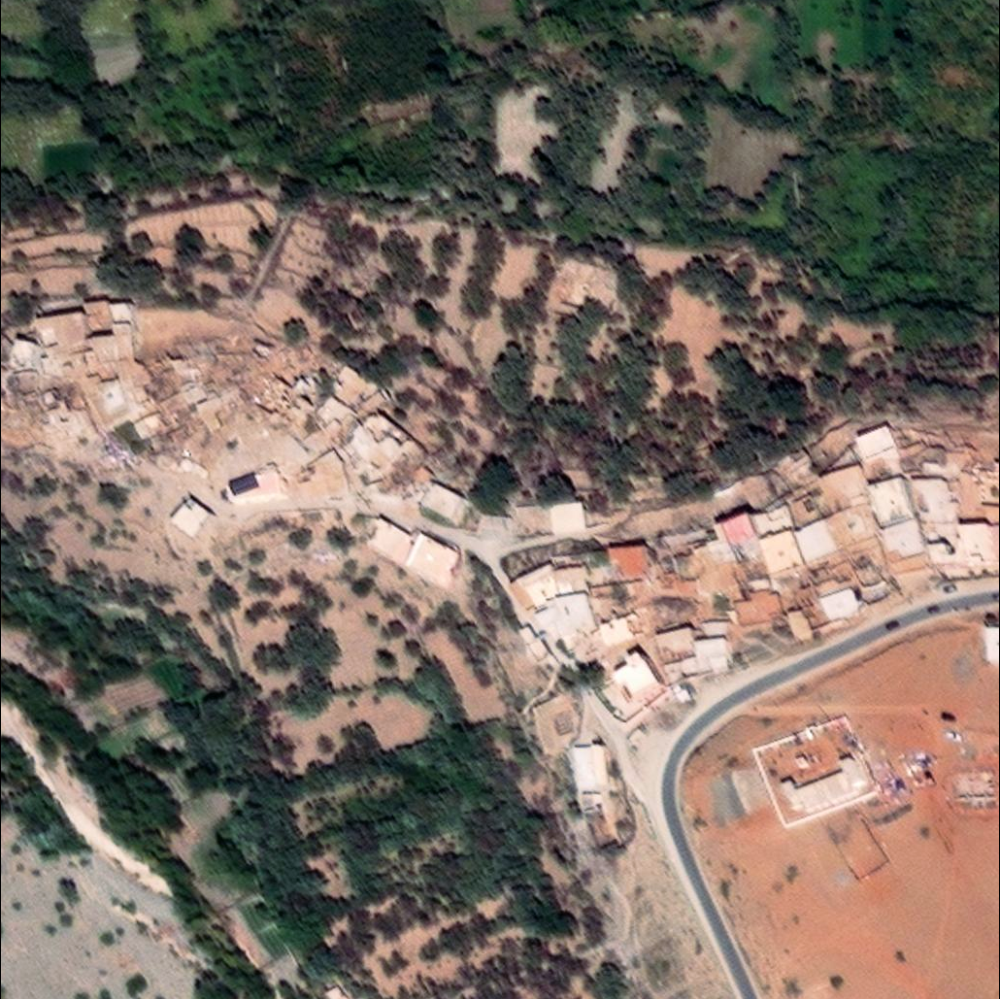
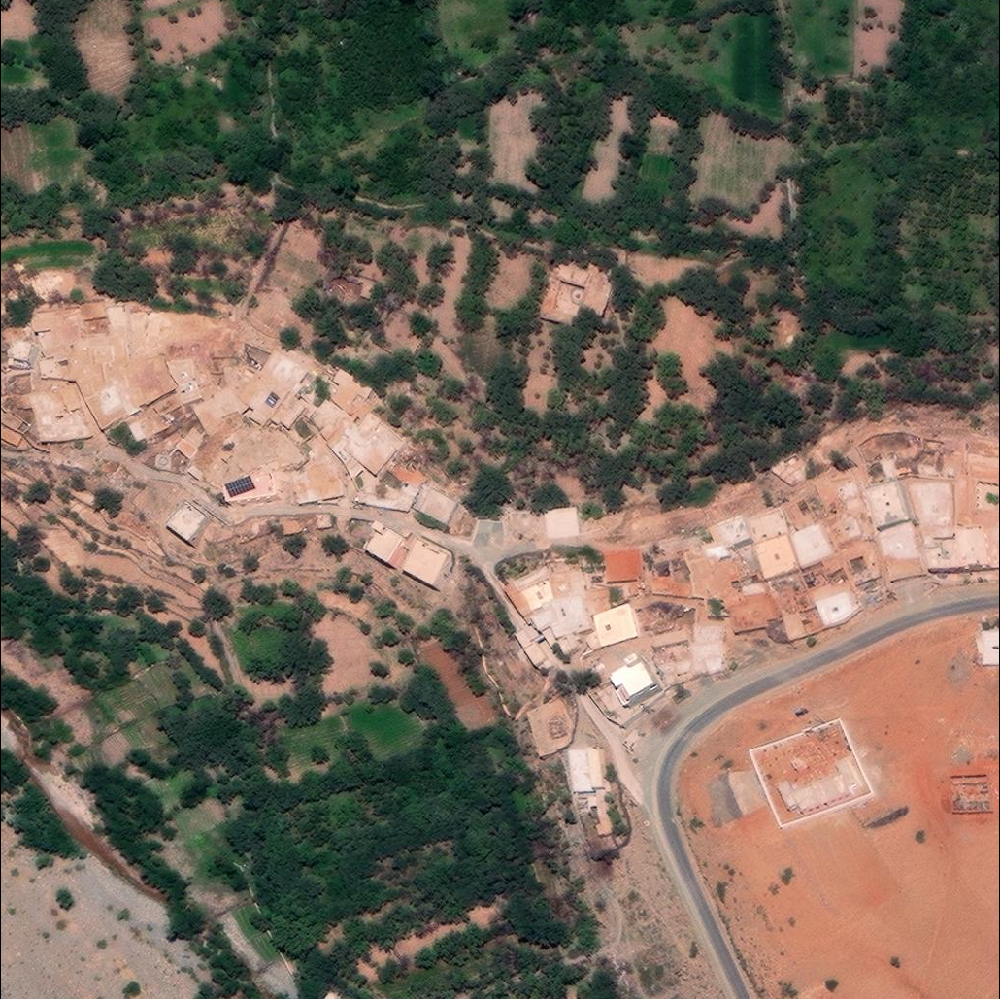

In [407]:
import folium
from folium import raster_layers
from shapely import Point 

rs_a_path = dataset.loc[dataset.id_pair == urban_path[1][0], "after_path"].item()
rs_a = rioxr.open_rasterio(rs_a_path)
data_a = rs_a.data.transpose(1, 2, 0)


rs_b_path = dataset.loc[dataset.id_pair == urban_path[1][0], "before_path"].item()
rs_b = rioxr.open_rasterio(rs_b_path)
data_b = rs_b.data.transpose(1, 2, 0)

loc = dataset.loc[dataset.id_pair == urban_path[1][0], "geometry"].item()

geom_building = get_building_from_location(loc, s_buffer)
#data = rs_b.data.transpose(1, 2, 0)

bbox = gpd.GeoSeries(box(*rs_a.rio.bounds()), crs=CRS).to_crs(4326)
min_lon, min_lat, max_lon, max_lat = bbox.bounds.values.squeeze()

# create the map
map_ = folium.Map(location=[min_lat, min_lon], zoom_start=17)

# Overlay the image
map_.add_child(raster_layers.ImageOverlay(data_a, opacity=0.9, \
         bounds =[[min_lat, min_lon], [max_lat, max_lon]], name="rs_a"))

# Overlay the image
map_.add_child(raster_layers.ImageOverlay(data_b, opacity=0.9, \
         bounds =[[min_lat, min_lon], [max_lat, max_lon]], name="rs_b"))

urban_13 = urban_path[1][1].drop_duplicates("geometry")
resample_urban = resample_urban.drop_duplicates("geometry")

folium.GeoJson(urban_13, name="osm_buffer_13", style_function=lambda x: {"color":"blue", "opacity":0.1}).add_to(map_)
folium.GeoJson(resample_urban, name="osm_buffer_12", style_function=lambda x: {"color":"blue", "opacity":0.1}).add_to(map_)

folium.GeoJson(geom_building, style_function=lambda x: {"color":"red", "opacity":0.1}, name="building").add_to(map_)

folium.LayerControl().add_to(map_)
map_

### Watershed segmentation

* On map les empreintes des batiments avec une segmentations watershed réalisée sur l'image post-event
* l'intuition est que les batiments provoque des gradients via sobel permettant de detourer grossièrement l'empreinte des batiments

In [89]:
from rasterio import features
segments_watershed = segments_watershed.astype(np.int16)
shapes = features.shapes(segments_watershed, mask=(segments_watershed == 0), transform=rs_b.rio.transform())

In [ ]:
io.imshow(rgb2gray(lines))

In [108]:
data = rs_b.data.transpose(1, 2, 0)
gradient = sobel(rgb2gray(data))
segments_watershed = watershed(gradient, markers=250, compactness=0.001,watershed_line=True)

lines = np.where(segments_watershed == 0, 1, 0)

/home/rustt/miniforge3/envs/damage_detection/lib/python3.10/site-packages/skimage/io/_plugins/matplotlib_plugin.py:149: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


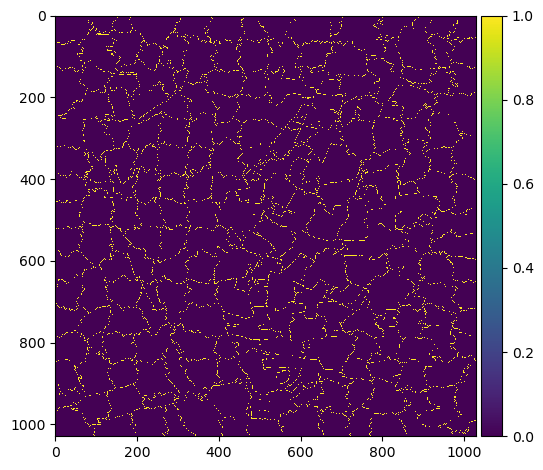

In [117]:
io.imshow(lines)

In [232]:
from shapely.geometry import shape as geo_shape
from rasterio.features import shapes as rio_shapes
from rasterio import features

data = rs_a.data.transpose(1, 2, 0)
gradient = sobel(rgb2gray(data))
segments_watershed = watershed(gradient, markers=500, compactness=0.0001,watershed_line=True)

lines = np.where(segments_watershed == 0, 1, 0)
lines = lines.astype(np.int16)
shape_gen = [(geo_shape(s), v) for s, v in rio_shapes(lines, transform=rs_b.rio.transform())]

gdf = gpd.GeoDataFrame(dict(zip(["geometry", "class"], zip(*shape_gen))), crs=rs_b.rio.crs)

In [228]:
urban_zone = gdf.sjoin(res, how="inner", predicate="intersects")

In [ ]:
urban_zone.to_file("urban_zone.shp")

gdf["id_seg"] = np.arange(len(gdf))

res["id_building"] = np.arange(len(res))

In [196]:
gpd.overlay(gdf,res, how="intersection")

,class,id_seg,id_building,geometry
0,0.0,55,70,"POLYGON ((570505.066 3444625.244, 570505.066 3..."
1,0.0,83,70,"POLYGON ((570505.371 3444625.244, 570508.144 3..."
2,1.0,148,70,"POLYGON ((570505.066 3444625.244, 570505.371 3..."
3,0.0,55,71,"POLYGON ((570496.024 3444614.258, 570496.156 3..."
4,1.0,148,71,"POLYGON ((570498.766 3444614.258, 570500.128 3..."
...,...,...,...,...
1038,1.0,3800,87,"POLYGON ((570577.698 3444328.613, 570577.717 3..."
1039,1.0,3815,117,"POLYGON ((570450.439 3444310.913, 570450.134 3..."
1040,0.0,3829,117,"POLYGON ((570450.134 3444310.913, 570445.565 3..."
1041,0.0,3830,117,"POLYGON ((570450.439 3444310.913, 570450.439 3..."


In [186]:
urban_zone.dissolve().centroid.to_crs(4326)

/home/rustt/miniforge3/envs/damage_detection/lib/python3.10/site-packages/pyproj/transformer.py:820: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  return self._transformer._transform_point(


0    POINT (-8.26055 31.13198)
dtype: geometry

In [188]:
rs_a = rioxr.open_rasterio(ds_test["after_path"].item())


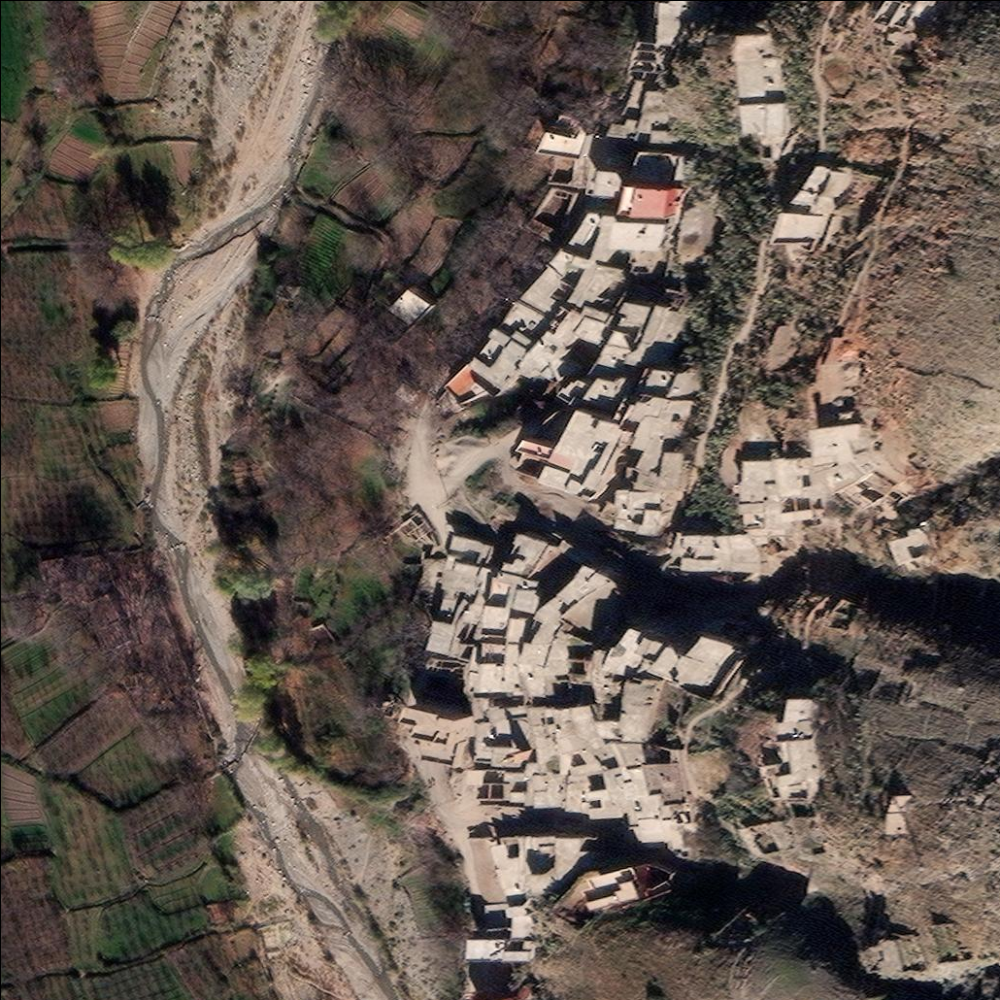

In [233]:
import folium
from folium import raster_layers
data = rs_a.data.transpose(1, 2, 0)
min_lon, min_lat, max_lon, max_lat = rs_b.rio.bounds()
# create the map
map_ = folium.Map(location=[31.13197, -8.26051], zoom_start=17)

data = rs_b.data.transpose(1, 2, 0)
bbox = gpd.GeoSeries(box(*rs_b.rio.bounds()), crs=CRS).to_crs(4326)
min_lon, min_lat, max_lon, max_lat = bbox.bounds.values.squeeze()

# Overlay the image
map_.add_child(raster_layers.ImageOverlay(data, opacity=0.8, \
         bounds =[[min_lat, min_lon], [max_lat, max_lon]]))


folium.GeoJson(urban_zone).add_to(map_)

map_

quickshift seems too slow because polygon are not closed

In [223]:
urban_zone.shape

(2659, 4)

Felzenszwalb number of segments: 3077
SLIC number of segments: 185
Quickshift number of segments: 4408
Watershed number of segments: 256


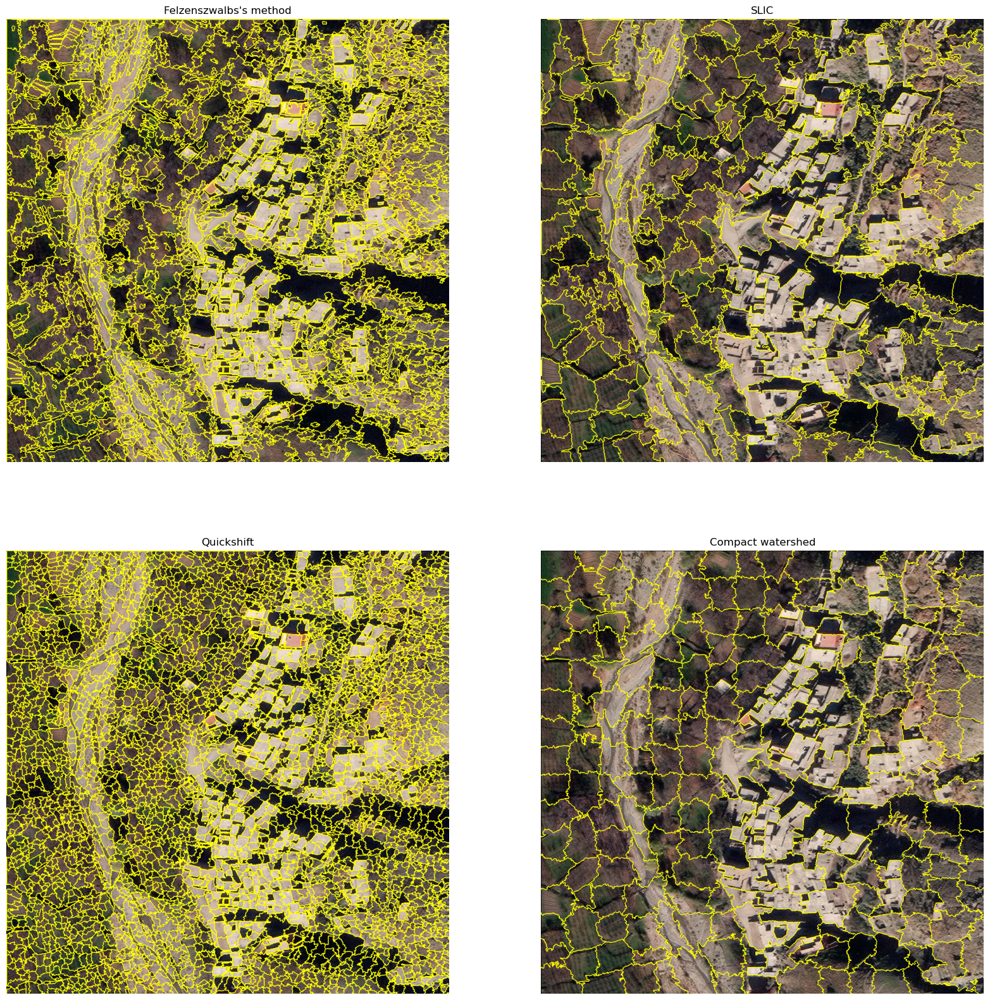

In [47]:
from skimage.color import rgb2gray
from skimage.filters import sobel
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float

img = img_as_float(rs_b.data.transpose(1, 2, 0))

segments_fz = felzenszwalb(img, scale=100, sigma=0.5, min_size=50)
segments_slic = slic(img, n_segments=250, compactness=10, sigma=1,
                     start_label=1)
segments_quick = quickshift(img, kernel_size=3, max_dist=6, ratio=0.5)
gradient = sobel(rgb2gray(img))
segments_watershed = watershed(gradient, markers=250, compactness=0.001)

print(f'Felzenszwalb number of segments: {len(np.unique(segments_fz))}')
print(f'SLIC number of segments: {len(np.unique(segments_slic))}')
print(f'Quickshift number of segments: {len(np.unique(segments_quick))}')
print(f'Watershed number of segments: {len(np.unique(segments_watershed))}')

fig, ax = plt.subplots(2, 2, figsize=(20, 20), sharex=True, sharey=True)

ax[0, 0].imshow(mark_boundaries(img, segments_fz))
ax[0, 0].set_title("Felzenszwalbs's method")
ax[0, 1].imshow(mark_boundaries(img, segments_slic))
ax[0, 1].set_title('SLIC')
ax[1, 0].imshow(mark_boundaries(img, segments_quick))
ax[1, 0].set_title('Quickshift')
ax[1, 1].imshow(mark_boundaries(img, segments_watershed))
ax[1, 1].set_title('Compact watershed')

for a in ax.ravel():
    a.set_axis_off()

In [38]:
rs.rio.crs

CRS.from_epsg(32629)

In [35]:
rs_in = rioxr.open_rasterio(ds_test["after_path"].item())

In [41]:
rs_b = rioxr.open_rasterio(ds_test["before_path"].item())

In [ ]:
rs_b

In [43]:
rs_b

<xarray.DataArray (band: 3, y: 1030, x: 1030)>
[3182700 values with dtype=uint8]
Coordinates:
  * band         (band) int64 1 2 3
  * x            (x) float64 5.703e+05 5.703e+05 ... 5.706e+05 5.706e+05
  * y            (y) float64 3.445e+06 3.445e+06 ... 3.444e+06 3.444e+06
    spatial_ref  int64 0
Attributes:
    AREA_OR_POINT:  Area
    scale_factor:   1.0
    add_offset:     0.0

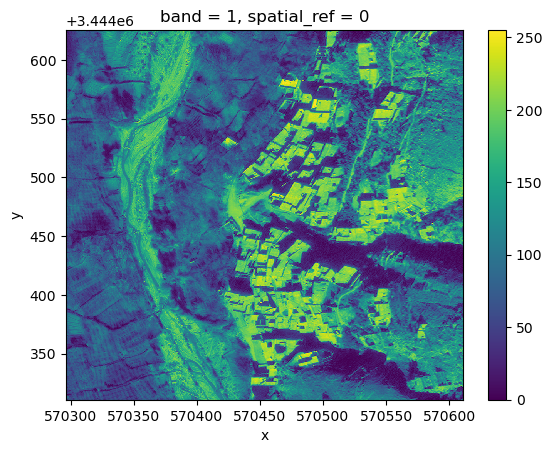

In [42]:
rs_b.sel(band=1).plot()

In [40]:
rs_in.rio.crs

CRS.from_epsg(32629)

In [37]:
rs_in.rio.bounds()

(570296.3256835938, 3444310.9130859375, 570610.6567382812, 3444625.244140625)

<Axes: >

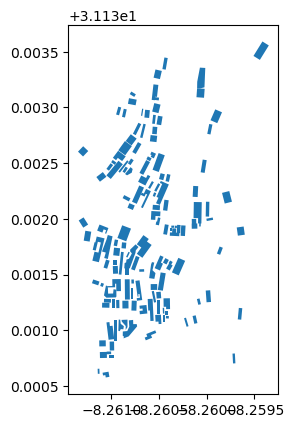

In [17]:
res.plot()

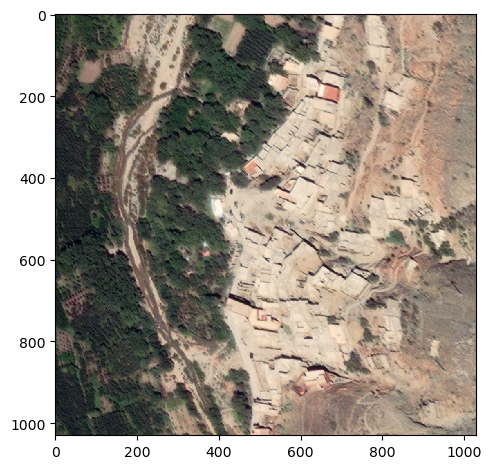

In [30]:
im = io.imread(ds_test["after_path"].item())
io.imshow(im)

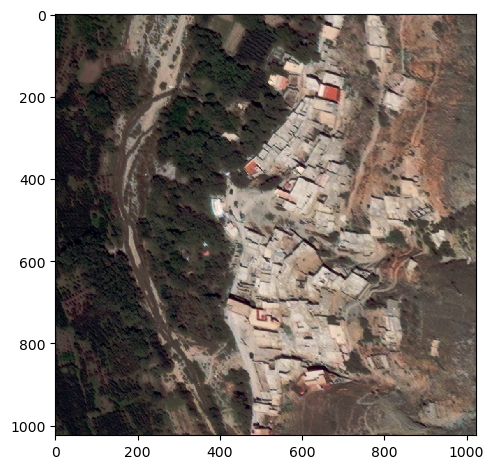

In [31]:
im = io.imread(ds_test["after_path_png"].item())
io.imshow(im)

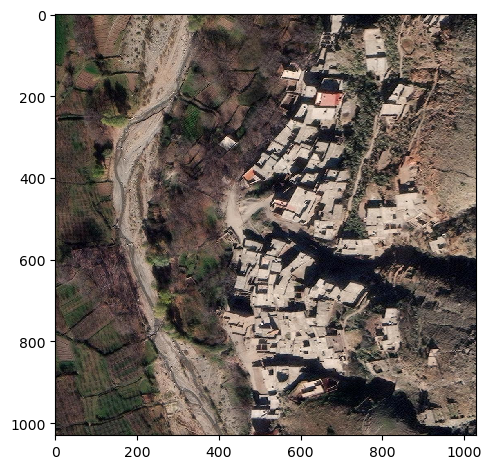

In [32]:
im = io.imread(ds_test["before_path"].item())
io.imshow(im)

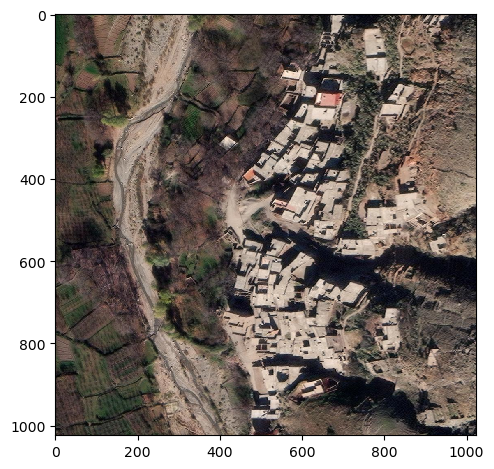

In [33]:
im = io.imread(ds_test["before_path_png"].item())
io.imshow(im)

In [ ]:
def extract_building_osm(shape: Union[gpd.GeoDataFrame, Polygon], crs_out=CRS):

    if isinstance(shape, gpd.GeoDataFrame): 
        if not shape.crs == 4326:
            shape = shape.to_crs(4326)
        shape = shape.geometry.item()
        
    res = ox.features_from_polygon(shape, tags={"building":True})
    
    town_area = (
        res
        .loc["node", ["name:fr", "place", "geometry"]]
        .reset_index()
        .rename({"name:fr":"town_name"}, axis=1)
        .to_crs(CRS)
    )
    nb_nan = town_area.town_name.isna().sum()
    town_area.loc[town_area.town_name.isna(), "town_name"] = list(map(str, np.arange(nb_nan)))

    return town_area